In [1]:
# nbi:hide_in
import numpy as np
import matplotlib.pylab as plt
from scipy.fftpack import fft, ifft,fftshift,ifftshift
from IPython.display import Audio

# Understanding Fourier Transform
The Fourier Transformation is applied in engineering to determine the dominant frequencies in a vibration signal. When the dominant frequency of a signal corresponds with the natural frequency of a structure, the occurring vibrations can get amplified due to resonance. This can happen to such a degree that a structure may collapse.
Now let's imagine you have bought a new sound system. A normal question is what kind of music is dangerous for your ears. in the next image there's an illustration of the frequencies of different things
![imagen](https://global.widex.com/-/media/images/blog/sound-levels-w600px.jpg?la=en&hash=E96CBA237C52F4E00C71285D20E834AAD23A7422)

Let’s use the Fourier Transform and examine where the spectrum of a song is located.
## Time signal
For the purpose of this example we are going to take a song of [Serj Takian  and Ara Malikian](https://www.youtube.com/watch?v=d9PYJdZisIE). the reason?, no reason, i like it! :D 

the following plot shows the first $0.52$ minutes of the song.
The Fourier transform is commonly used to convert a signal in the time spectrum to a frequency spectrum.
As can clearly be seen it looks like a wave with different frequencies. Actually it looks like multiple waves.

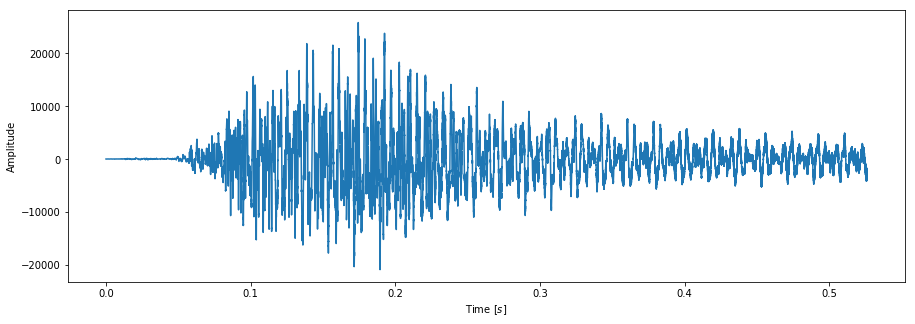

In [2]:
# nbi:hide_in
from scipy.io import wavfile
filename="The Rough Dog.wav"
fs, data = wavfile.read(filename)
#Audio(data=data.reshape(data.shape[0]*2),rate=2*fs)
audio=data.reshape(data.shape[0]*2)
#Audio(data=audio[:13000],rate=2*fs)
plt.figure(figsize=(15,5))
plt.plot(np.linspace(0,len(audio[65000:2*fs])/44100,len(audio[65000:2*fs])),audio[65000:2*fs])
plt.ylabel("Amplitude")
plt.xlabel(r"Time [$s$]")
plt.show()

## Fourier Transform
This is where the Fourier Transform comes in. This method makes use of the fact that every non-linear function can be represented as a sum of (infinite) sine waves ( the reason behind this is that $sin$ and $cos$ form a complete basis). In the underlying figure this is illustrated, as a step function is simulated by a multitude of sine waves.

![image](https://www.ritchievink.com/img/post-5-fft/fig_2.png)

A Fourier Transform will break apart a time signal and will return information about the frequency of all sine waves needed to simulate that time signal. For sequences of evenly spaced values the Discrete Fourier Transform (DFT) is defined as:
$$
X_k=\sum_{n=0}^{N-1}x_n e^{-2\pi i kn/N},
$$
where
* $N$ = number of samples
* $n$ = current sample
* $x_n$ = value of the sinal at time n
* $k$ = current frequency (0 Hz to N-1 Hz)
* $X_k$ = Result of the DFT (amplitude and phase)

Note that a dot product is defined as:
$$
\vec{a}\cdot\vec{b} = \sum_{n=1}^{\text{dim(a)}}a_{i}b_{i},
$$
where $dim(a)$ means the dimension of the space where $\vec{a}$ lives.
So a simple algorithm to do the DFT can be written as:
```python
import numpy as np

def DFT(x):
    """
    Compute the discrete Fourier Transform of the 1D array x
    :param x: (array)
    """

    N = x.size
    n = np.arange(N)
    k = n.reshape((N, 1))
    e = np.exp(-2j * np.pi * k * n / N)
    return np.dot(e, x)

```

However if we run this code on our time signal, which contains approximately $7,938,000$ values, it takes forever to run, because this haven't been optimized. Luckily some clever guys [Cooley and Tukey](https://en.wikipedia.org/wiki/Cooley%E2%80%93Tukey_FFT_algorithm) have come up with the Fast Fourier Transform (FFT) [algorithm](https://www.cs.dartmouth.edu/~rockmore/cse-fft.pdf), on their [paper](https://www.ams.org/journals/mcom/1965-19-090/S0025-5718-1965-0178586-1/), which recursively divides the DFT in smaller DFT’s bringing down the needed computation time drastically. A standard DFT scales O(N2) while the FFT scales O(N log(N)).

# Simple example
He have talked about Fourier transforms and how to use it fast and what information they give us. But now let's start with our example. First we import all we are going to need.
```python
import numpy as np
import matplotlib.pylab as plt
from scipy.fftpack import fft, ifft,fftshift,ifftshift
```

Let’s write some code to find out what an FFT is actually doing.

First we define a simple signal containing an addition of two sine waves. One with a frequency of 40 Hz and one with a frequency of 90 Hz.
```python
t = np.linspace(0, 0.5, 500)
s = np.sin(40 * 2 * np.pi * t) + 0.5 * np.sin(90 * 2 * np.pi * t)

plt.ylabel("Amplitude")
plt.xlabel("Time [s]")
plt.plot(t, s)
plt.show()
```

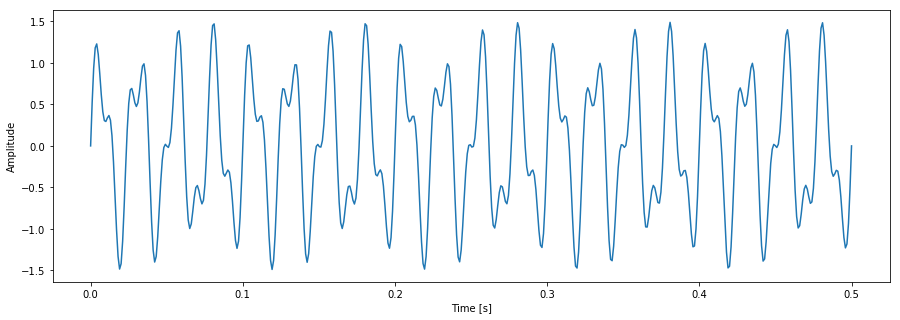

In [3]:
# nbi:hide_in
plt.figure(figsize=(15,5))
t = np.linspace(0, 0.5, 500)
s = np.sin(40 * 2 * np.pi * t) + 0.5 * np.sin(90 * 2 * np.pi * t)

plt.ylabel("Amplitude")
plt.xlabel("Time [s]")
plt.plot(t, s)
plt.show()

In order to retrieve a spectrum of the frequency of the time signal mentioned above we must take a FFT on that sequence.

with numpy
```python
fft = np.fft.fft(s)
```
or equivalent with scipy 

``` python
fft = fft(s)
```
```python
for i in range(2):
    print("Value at index {}:\t{}".format(i, fft[i + 1]), "\nValue at index {}:\t{}".format(fft.size -1 - i, fft[-1 - i]))
```

In [4]:
# nbi:hide_in
fft_result = fft(s)
for i in range(2):
    print("Value at index {}:\t{}".format(i, fft_result[i + 1]), "\nValue at index {}:\t{}".format(fft_result.size -1 - i, fft_result[-1 - i]))

Value at index 0:	(0.00038048349283981153-0.06055503176189933j) 
Value at index 499:	(0.00038048349283981153+0.06055503176189933j)
Value at index 1:	(0.0015317714831376839-0.12188808528069249j) 
Value at index 498:	(0.0015317714831376839+0.12188808528069249j)


In the above code snippet the FFT result of the two sine waves is determined. The first two and the last two values of the FFT sequence were printed to stdout. As we can see we get complex numbers as a result. If we compare the first value of the sequence (index 0) with the last value of the sequence (index 499) we can see that the real parts of both numbers are equal and that the value of the imaginary numbers are also equal in magnitude, only one is positive and the other is negative. The numbers are each others complex conjugate. This is true for all numbers in the sequence;

For real number inputs is $n$ the complex conjugate of $N - n$.

Because the second half of the sequence gives us no new information we can already conclude that the half of the FFT sequence is the output we need.

The complex output numbers of the FFT contains the same information as a complex number:
* __Amplitude__ of a certain frequency sine wave (energy).
* __Phase__ offset of a certain frequency sine wave.
so four our purpose is better if we look at the amplitude (so we take the norm of the complex number)
## Spectrum
Since we are interested in the energy at a specific frequency we have to plot the result of the Fourier transform as a function of the frequencies, and the frequency resolution is given by
$$
\Delta f=\frac{f_s}{N}
$$
Finally plotting all together we can see result of our FT.

```python
fft = np.fft.fft(s)
T = t[1] - t[0]  # sampling interval 
N = s.size

# 1/T = frequency
f = np.linspace(0, 1 / T, N)

plt.ylabel("Amplitude")
plt.xlabel("Frequency [Hz]")
plt.bar(f[:N // 2], np.abs(fft)[:N // 2] * 1 / N, width=1.5)  # 1 / N is a normalization factor
plt.show()
```

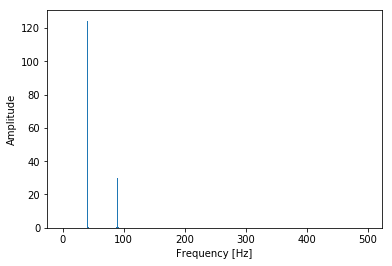

In [5]:
# nbi:hide_in
fft_result = np.fft.fft(s)
T = t[1] - t[0]  # sampling interval 
N = s.size

# 1/T = frequency
f = np.linspace(0, 1 / T, N)

plt.ylabel("Amplitude")
plt.xlabel("Frequency [Hz]")
plt.bar(f[:N // 2], (fft_result*fft_result.conjugate())[:N // 2].real * 1 / N, width=1.5)  # 1 / N is a normalization factor
plt.show()

As we can see the FFT works! It has given us information about the frequencies of the waves in the time signal.

Now let's test with something more interesting.

# Example using a song
Let's import all we need

```python
import numpy as np
import matplotlib.pylab as plt
from scipy.fftpack import fft, ifft,fftshift,ifftshift
from IPython.display import Audio
from scipy.io import wavfile
```
<b><font color='red'>Warning</font></b>: this code will work only in a Jupyter notebook, if you test it from terminal it does not work.
I have an audio of a part of the song ( The format of the song must be en .wav format if you do not have your song in .wav you can always convert it either via your terminal or [Online](https://audio.online-convert.com/convert-to-wav)). The song can be downloaded [here](https://github.com/JoseMontanaC/Laboratorio-Metodos-Computacionales/blob/master/The%20Rough%20Dog.wav?raw=true). Therefore the code to open this:
```python
filename="The Rough Dog.wav" # set the path were the file is, in my case i have it in the same folder
fs, data = wavfile.read(filename) # fs is the frequency, data is an array with the values of the song (shape=(3969000, 2))
audio=data.reshape(data.shape[0]*2) # we reshape our data to get the audio
```
In order to display what is in the array ``audio`` we use the function ``Audio`` from ``IPython.display``.
```python
Audio(data=audio,rate=2*fs)
```

In [6]:
# nbi:hide_in
Audio(data=audio,rate=2*fs)

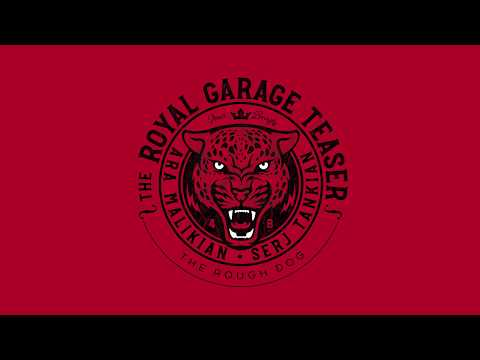

In [7]:
# nbi:hide_in
from IPython.display import YouTubeVideo
YouTubeVideo("d9PYJdZisIE")

Now we compute the Fourier transform and we compute the frequencies to plot the Fourier transform of the song
```python
Fourier=fft(audio) # compute the FFT
N=len(audio)
frequencies=np.fft.fftfreq(N,d=1/(fs))
norm_Fourier=(Fourier*Fourier.conjugate()).real
plt.plot(frequencies[:N//2],norm_Fourier[:N//2]/N)
plt.yscale("log")
```

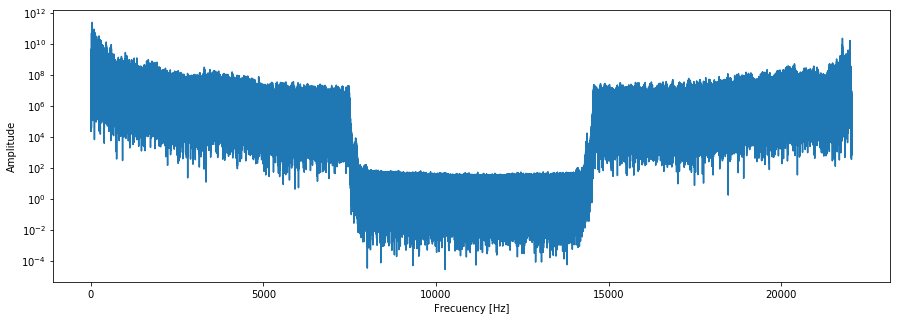

In [8]:
# nbi:hide_in
filename="The Rough Dog.wav"
fs, data = wavfile.read(filename)
audio=data.reshape(data.shape[0]*2)
N=len(audio)
Fourier=fft(audio) # compute the FFT
frequencies=np.fft.fftfreq(N,d=1/(fs))
norm_Fourier=(Fourier*Fourier.conjugate()).real
plt.figure(figsize=(15,5))
plt.plot(frequencies[:N//2],norm_Fourier[:N//2]/N)
plt.yscale("log")
plt.ylabel("Amplitude")
plt.xlabel("Frecuency [Hz]")
plt.show()

With this information we can therefore implement a filter, let's say for example i don't want to hear frequencies bigger than 10k and smaller than 500 Hz. so we do:
```python
Fourier[(np.abs(frequencies)<500) | (np.abs(frequencies)>10000)]=0
tmp=ifft(Fourier).real
Audio(data=tmp,rate=2*fs)
```

In [9]:
# nbi:hide_in
Fourier=fft(audio)
Fourier[(np.abs(frequencies)<600) | (np.abs(frequencies)>5000)] = 0
tmp=ifft(Fourier).real
Audio(data=tmp,rate=2*fs)

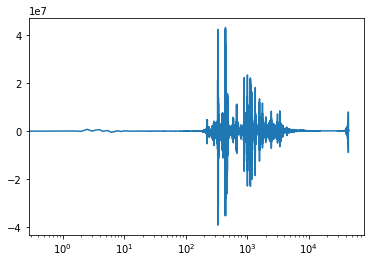

In [17]:
Fourier=fft(audio[:4*fs])
frequencies=np.fft.fftfreq(len(audio[:4*fs]),d=1/(2*fs))
plt.plot(frequencies[:len(frequencies)//2],Fourier[:len(frequencies)//2])
plt.xscale("log")

# Exercise
Use the last code to implement your own filters ( at least 2 different filters) and display the output of your result, what can you conclude from your results.
__Hint__: you can try to isolate an instrument or maybe the voice of the singer. (try with short songs)